The following notebook is a collection of different optimizations to compare various approaches regarding the CLIP model, the regularization and the prompt style.

The optimization has been tested on three different prompts:

* Simple prompt: "sunset"
* Complex prompt 1: "A sunset in a forest, cloudy, with trees"
* Complex prompt 2: "A sunny day at the beach, clear sky, sand terrain"

# Imports and initialization

### Imports

In [1]:
import torch
from model import VAE
import torchvision
from PIL import Image
import matplotlib.pyplot as plt
import clip
import torchvision.transforms as transforms
from tqdm import tqdm
from torchmetrics.image import TotalVariation
import os
import numpy as np
import gc

In [2]:
DEVICE = "cuda"

model = VAE().to(DEVICE)
model.load_state_dict(torch.load("train_results/model_weights_final.pth"))
to_tensor = torchvision.transforms.functional.to_tensor

dummy input shape  torch.Size([4096])


### Functions

In [3]:
def plot_loss(loss):
    f,ax=plt.subplots(figsize=(5,3))
    plt.plot(loss['optim_loss'])
    plt.suptitle("Optimization loss");

In [4]:
def plot_image(img):
    img = img[0].permute(1,2,0).detach().cpu()
    height, width, depth = img.shape

    # What size does the figure need to be in inches to fit the image?
    figsize = width/64 , height/64
    fig, ax = plt.subplots(figsize=figsize)
    ax.imshow(img.numpy(), interpolation='nearest')

In [5]:
def plot_comparison(before, after):

    before = before[0].permute(1,2,0).detach().cpu()
    after  = after[0].permute(1,2,0).detach().cpu()

    f, axarr = plt.subplots(2)
    f.tight_layout()
    axarr[0].imshow(before)
    axarr[0].set_title("Before") 
    axarr[1].imshow(after)
    axarr[1].set_title("After") 

In [6]:
transform_normalize = transforms.Compose([
        transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225])
    ])

In [7]:
def plot_image_batch(batch, title, labels):
    batch = batch.permute(0, 2, 3, 1).detach().cpu()
    
    num_rows, num_cols = 3, 3
    f, axarr = plt.subplots(num_rows, num_cols, figsize=(10, 6))
    plt.suptitle(title)
    
    for i in range(num_rows):
        for j in range(num_cols):
            index = i * num_cols + j
            axarr[i, j].imshow(batch[index])
            axarr[i, j].axis('off')
            axarr[i, j].set_title(labels[index], fontsize=10)


In [8]:
def plot_image_list(batch, title, labels, num_rows=3, num_cols=3, figsize=(10, 6)):
    f, axarr = plt.subplots(num_rows, num_cols, figsize=figsize)
    plt.suptitle(title)
    
    for i in range(num_rows):
        for j in range(num_cols):
            index = i * num_cols + j
            axarr[i, j].imshow(batch[index].squeeze(0).permute(1,2,0))
            axarr[i, j].axis('off')
            axarr[i, j].set_title(labels[index], fontsize=10)


In [9]:
def plot_loss_batch(losses, title, labels, key="optim_loss"):
    num_rows, num_cols = 3, 3
    f, axarr = plt.subplots(num_rows, num_cols, figsize=(10, 8))
    plt.suptitle(title)
    for i in range(num_rows):
        for j in range(num_cols):
            index = i * num_cols + j
            axarr[i, j].plot(losses[index][key])
            axarr[i, j].set_title(f'Image {index+1}')
            axarr[i, j].set_xlabel('Epoch')
            axarr[i, j].set_ylabel('Loss')
            axarr[i, j].set_title(labels[index],fontsize=10)
            axarr[i, j].tick_params(axis='both', labelsize=8)
            axarr[i, j].xaxis.set_major_locator(plt.MaxNLocator(integer=True))
    plt.tight_layout()

# VAE Starting Point

Nine images are sampled randomly from the PolyHaven dataset, and initialized with the Variational Auto Encoder (VAE) inference.

In [10]:
import random
random.seed(64)
img_names = os.listdir("dataset/polyhaven_png_128/")
images_filenames = random.sample(img_names, 9)

images_labels = [label[:-7] for label in images_filenames]

images_filenames

['harties_1k.png',
 'belfast_farmhouse_1k.png',
 'lot_02_1k.png',
 'lenong_2_1k.png',
 'flower_road_1k.png',
 'kloetzle_blei_1k.png',
 'rural_landscape_1k.png',
 'moulton_falls_train_tunnel_east_1k.png',
 'abandoned_hall_01_1k.png']

In [11]:
x_tensors = torch.from_numpy(np.array([to_tensor(Image.open("dataset/polyhaven_png_128/{}".format(img))) for img in images_filenames])).to(DEVICE)
x_tensors.shape

torch.Size([9, 3, 128, 256])

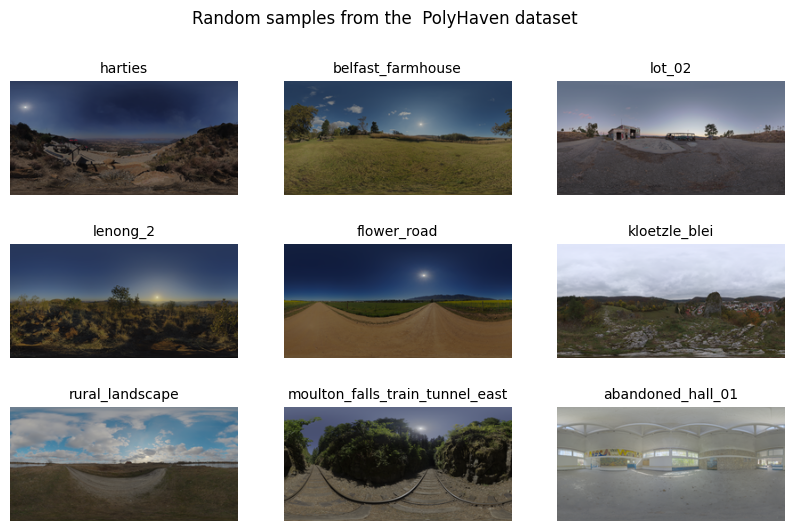

In [12]:
plot_image_batch(x_tensors, title="Random samples from the  PolyHaven dataset", labels=images_labels)

In [13]:
# Normalize x as intended for input in the VAE
x_norm = transform_normalize(x_tensors)

/home/antonio/miniconda3/envs/nlp-env/lib/python3.11/site-packages/torch/nn/modules/conv.py:459: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1682343995622/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


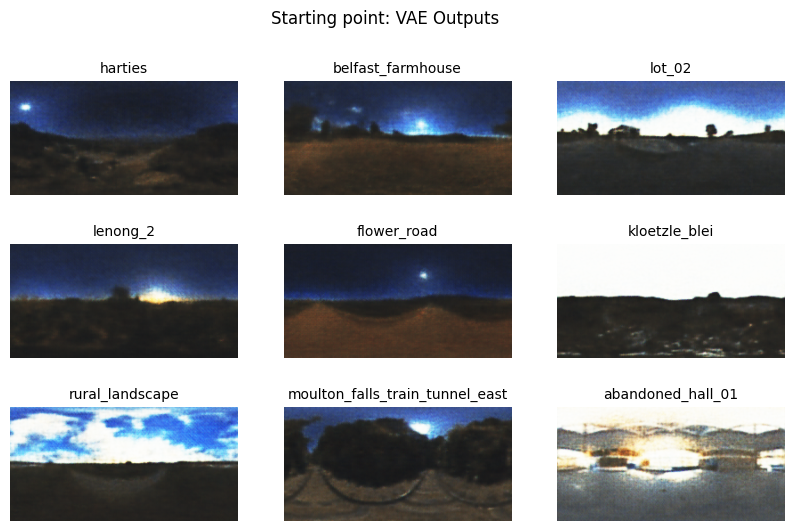

In [14]:
def full_inference(model, input):
    model.eval()
    with torch.no_grad():
            mu, sigma = model.encode(input)
            z = model.reparameterize(mu, sigma)
            output = model.decode(z)
            
    return output

y = full_inference(model, x_norm)

plot_image_batch(y, title="Starting point: VAE Outputs", labels=images_labels)

# CLIP loss

In [15]:
class CustomCLIPLoss(torch.nn.Module):

    def __init__(self, clip_model="ViT-B/32", checkpoint=None):#, resize=224):
        super(CustomCLIPLoss, self).__init__()
        self.model, clip_preprocess = clip.load(clip_model, device="cuda", jit=False)
        self.model.eval()

        if checkpoint is not None:
            # source: https://github.com/openai/CLIP/issues/83
            ckpt = torch.load(checkpoint)
            self.model.load_state_dict(ckpt)
    
        # Remove from the CLIP preprocessor the PIL related operations
        self.preprocess = transforms.Compose([
                clip_preprocess.transforms[0],
                clip_preprocess.transforms[1],
                clip_preprocess.transforms[4]
        ])

    def forward(self, image, text, crop=True):
        image = self.preprocess(image) 
        
        image_features = self.model.encode_image(image)
        text_features = self.model.encode_text(text)
        
        similarity = torch.nn.functional.cosine_similarity(image_features, text_features)

        return 1-similarity
    

    def similarity(self, image, text, crop=True):
        image = self.preprocess(image) 
        
        image_features = self.model.encode_image(image)
        text_features = self.model.encode_text(text)
        
        similarity = torch.nn.functional.cosine_similarity(image_features, text_features)

        return similarity

'\n\nclass CustomCLIPLoss(torch.nn.Module):\n\n    def __init__(self, clip_model="ViT-B/32", checkpoint=None):#, resize=224):\n        super(CustomCLIPLoss, self).__init__()\n        self.model, clip_preprocess = clip.load(clip_model, device="cuda", jit=False)\n        \n        if checkpoint is not None:\n            # source: https://github.com/openai/CLIP/issues/83\n            ckpt = torch.load(checkpoint)\n            self.model.load_state_dict(ckpt)\n    \n        # Remove from the CLIP preprocessor the PIL related operations\n        self.preprocess = transforms.Compose([\n                clip_preprocess.transforms[0],\n                clip_preprocess.transforms[1],\n                clip_preprocess.transforms[4]\n        ])\n\n        self.preprocess_no_crop = transforms.Compose([\n                clip_preprocess.transforms[0],\n                clip_preprocess.transforms[4]\n        ])\n\n    def forward(self, image, text, crop=True):\n        image = self.preprocess(image) if c

In [16]:
clip_loss = CustomCLIPLoss()

# CLIP optimization

In [17]:
def get_optimizer(var, lr, weight_decay=0):
    var_optim = var.clone().detach().requires_grad_(True)
    optimizer = torch.optim.Adam([var_optim], lr=lr, weight_decay=weight_decay)
    return var_optim, optimizer

## Optimization on plain pixels

In this example, I show that optimizing on plain pixels is not enough: the sparsity nature of the problems makes it impossible for the optimizer to reconstruct what is given in the prompt, resulting in a noisy image

In [18]:
results = torch.zeros(x_tensors.shape)
histories = []

In [19]:
for i, x in enumerate(x_tensors): 
    x = x.unsqueeze(0)
    img_optim, optimizer = get_optimizer(x, lr=1e-3, weight_decay=1e-5)
    prompt = "sunset"
    text = clip.tokenize(prompt).to(device="cuda")

    history={}
    history={'optim_loss':[]}

    loop = tqdm(range(3))

    for it in loop:
        loss_clip = clip_loss(img_optim, text)
        loss = loss_clip
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        loop.set_postfix(loss=loss.item())
        history['optim_loss'].append(loss.item())

    results[i] = x.squeeze(0)
    histories.append(history)

  0%|          | 0/3 [00:00<?, ?it/s]/home/antonio/miniconda3/envs/nlp-env/lib/python3.11/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
100%|██████████| 3/3 [00:00<00:00, 20.53it/s, loss=0.753]


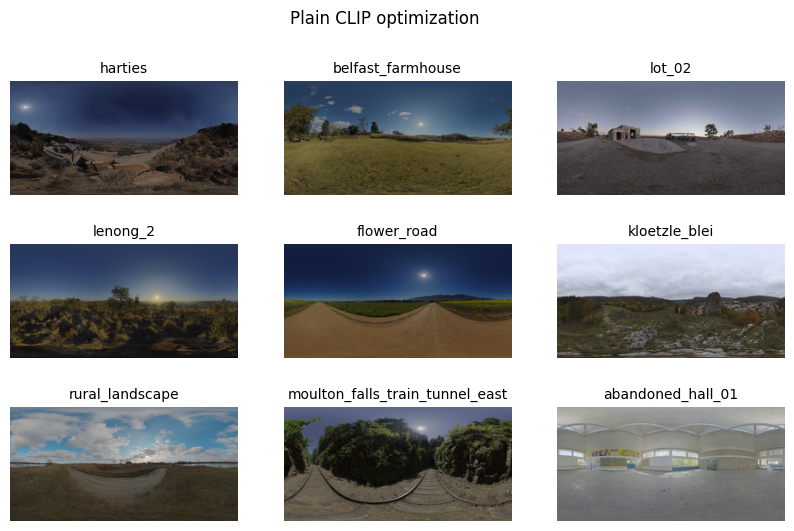

In [20]:
plot_image_batch(results, "Plain CLIP optimization", images_labels)

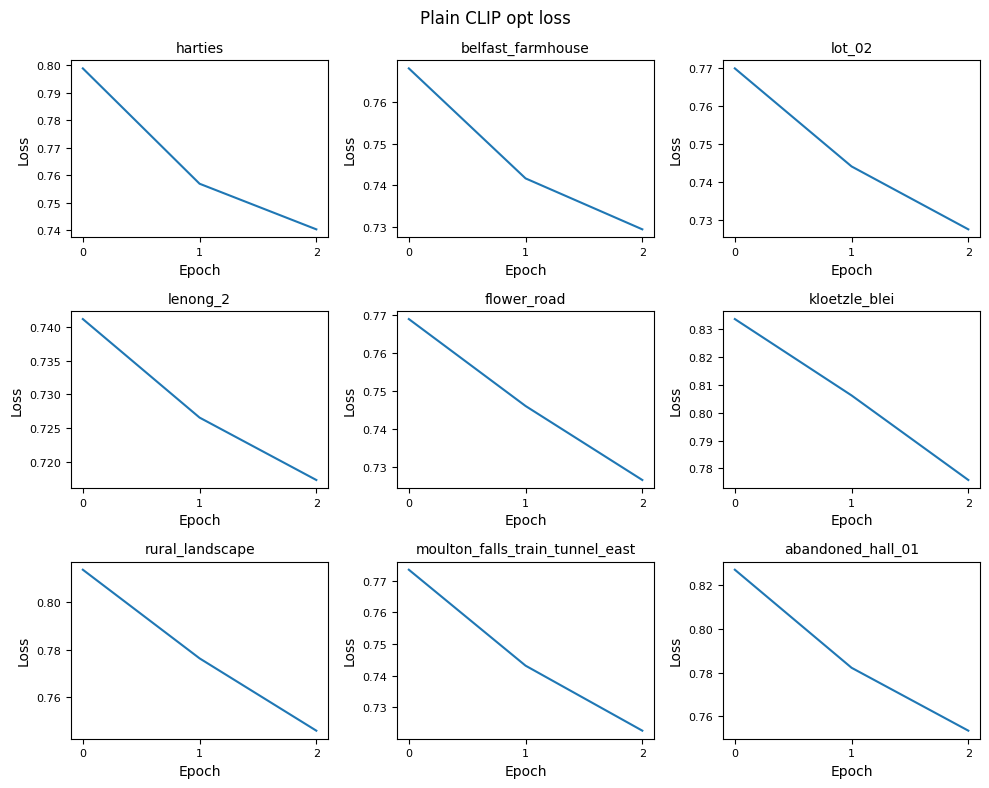

In [21]:
plot_loss_batch(histories, title="Plain CLIP opt loss", labels=images_labels)

## Optimization on the VAE latent space

#### Optimization on z

In [22]:
def decode_z(model, z):
    model.eval()

    mu, sigma = model.get_mu_logvar(z)
    z_rep = model.reparameterize(mu, sigma)
    
    output = model.decode(z_rep)
    return output

#### Optimization on mu, logvar

In [23]:
import torch.nn as nn
class LatentParameters(nn.Module):
    def __init__(self, mu, logvar):
        super(LatentParameters, self).__init__()
        self.mu = nn.Parameter(mu.clone().detach().requires_grad_(True))
        self.logvar = nn.Parameter(logvar.clone().detach().requires_grad_(True))

In [24]:
def decode_mu_logvar(model, mu, sigma):
    model.eval()
    z_rep = model.reparameterize(mu, sigma)
    output = model.decode(z_rep)
    return output

In [25]:
def get_optimizer_distrib(mu, logvar, lr, weight_decay=0):
    parameters = LatentParameters(mu, logvar)
    optimizer = torch.optim.Adam(parameters.parameters(), lr=lr, weight_decay=weight_decay)
    return parameters, optimizer

## Latent Optimization Function

In [26]:
from torchmetrics.image.fid import FrechetInceptionDistance

import torch.nn.functional as F
'''
    optim_type : "fc", "mu_logvar"  
    tv : float
    kl : float
'''

def clip_latent_optimize(input, prompt, vae_model, clip_loss, optim_type="fc", n_iter=1600, tv = 0, kl = 0, lr=0.01, weight_decay=1e-3):
    tf_img = None

    text = clip.tokenize(prompt).to(device="cuda")
    tv_loss = TotalVariation().to(DEVICE)
    kl_loss = nn.KLDivLoss(reduction="batchmean").to(DEVICE)

    history=[]

    if optim_type == "fc":
        
        z = model.encode_only(input) 
        z_optim, optimizer = get_optimizer(z, lr=lr, weight_decay=weight_decay)
        scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=150, gamma=0.5)

        loop = tqdm(range(n_iter))
        for it in loop:
            tf_img = decode_z(vae_model, z_optim)

            loss_clip = clip_loss(tf_img, text)
            loss_tv = tv * tv_loss(tf_img) if tv>0 else 0

            if kl>0:
                kl_input = F.log_softmax(tf_img)
                kl_target = F.log_softmax(input)
                loss_kl = kl * kl_loss(kl_input, kl_target)

            else:
                loss_kl = 0

            loss = loss_clip + loss_tv + loss_kl
        
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            scheduler.step()
            loop.set_postfix(loss=loss.item(), loss_clip=loss_clip.item(), loss_tv=tv_loss)
            history.append(loss.cpu().item())

        output = decode_z(vae_model, z_optim)

    elif optim_type == "mu_logvar":
        mu, logvar = model.encode(input)
        parameters_optim, optimizer = get_optimizer_distrib(mu, logvar, lr=lr, weight_decay=weight_decay)
        scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=150, gamma=0.5)

        loop = tqdm(range(n_iter))
        for it in loop:
            tf_img = decode_mu_logvar(vae_model, parameters_optim.mu, parameters_optim.logvar)

            loss_clip = clip_loss(tf_img, text)
            loss_tv = tv * tv_loss(tf_img) if tv > 0 else 0

            if kl>0:
                kl_input = F.log_softmax(tf_img)
                kl_target = F.log_softmax(input)
                loss_kl = kl * kl_loss(kl_input, kl_target)

            else:
                loss_kl = 0


            loss = loss_clip + loss_tv + loss_kl

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            scheduler.step()
            loop.set_postfix(loss=loss.item(), loss_clip=loss_clip.item(), loss_tv=loss_tv)
            history.append(loss.cpu().item())

        output = decode_mu_logvar(vae_model, parameters_optim.mu, parameters_optim.logvar)

    else: 
        raise ValueError('Accepted optim_type: fc or mu_logvar')

    final_cos_sim = clip_loss.similarity(tf_img, text).cpu()

    return output.cpu(), history, final_cos_sim


## Batch Optimization Function

In [27]:
def batch_optimize(x_norm, optim_type, prompt, n_iter, loss_fn, tv=0, kl=0):
    results = {"outputs": [], "histories": [], "cos_sims": []}
    
    for x in x_norm:
        x = x.unsqueeze(0)
        output, history, cos_sim = clip_latent_optimize(x, prompt, model, loss_fn, n_iter=n_iter, optim_type=optim_type, tv=tv, kl=kl, lr=0.01, weight_decay=1e-3)
        
        results["outputs"].append(output.detach())
        results["histories"].append(history)
        results["cos_sims"].append(cos_sim.detach())
    
        del x
        del output
        del history
        del cos_sim
        gc.collect()
        torch.cuda.empty_cache()
    return results


# Experiments

## Simple prompt

### Base CLIP

In [28]:
import torch

N_ITER = 400
PROMPT = "sunset"
results_simple_prompt = {}

# Reinitialize clip_loss everytime to prevent CUDA out-of-memory
clip_loss=None
gc.collect()
torch.cuda.empty_cache()

clip_loss = CustomCLIPLoss(clip_model="ViT-B/32")

# Optimize on z, only l2 regularization
results_simple_prompt["clipbase_fc_no_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on z, total variation regularization
results_simple_prompt["clipbase_fc_tv_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, only l2 regularization
results_simple_prompt["clipbase_mulogvar_no_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, total variation regularization
results_simple_prompt["clipbase_mulogvar_tv_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, KL regularization
results_simple_prompt["clipbase_mulogvar_kl_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, kl=1e-3)
gc.collect()
torch.cuda.empty_cache()



  0%|          | 0/400 [00:00<?, ?it/s]/tmp/ipykernel_7562/1953931239.py:65: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_input = F.log_softmax(tf_img)
/tmp/ipykernel_7562/1953931239.py:66: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_target = F.log_softmax(input)
100%|██████████| 400/400 [00:22<00:00, 17.74it/s, loss=nan, loss_clip=0.779, loss_tv=0]


### CLIP with PolyHaven finetune

In [29]:
N_ITER = 400
PROMPT = "sunset"

# Reinitialize clip_loss everytime to prevent CUDA out-of-memory
clip_loss=None
gc.collect()
torch.cuda.empty_cache()

clip_loss = CustomCLIPLoss(clip_model="ViT-B/32", checkpoint="clip_checkpoints/clip_finetuned_polyhaven.pt")

# Optimize on z, only l2 regularization
results_simple_prompt["clippolyhaven_fc_no_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on z, total variation regularization
results_simple_prompt["clippolyhaven_fc_tv_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, only l2 regularization
results_simple_prompt["clippolyhaven_mulogvar_no_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, total variation regularization
results_simple_prompt["clippolyhaven_mulogvar_tv_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, KL regularization
results_simple_prompt["clippolyhaven_mulogvar_kl_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, kl=1e-3)
gc.collect()
torch.cuda.empty_cache()

  0%|          | 0/400 [00:00<?, ?it/s]/tmp/ipykernel_7562/1953931239.py:65: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_input = F.log_softmax(tf_img)
/tmp/ipykernel_7562/1953931239.py:66: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_target = F.log_softmax(input)
100%|██████████| 400/400 [00:22<00:00, 17.78it/s, loss=nan, loss_clip=0.793, loss_tv=0]


### VAE model

In [30]:
clip_loss=None
gc.collect()
torch.cuda.empty_cache()

clip_loss = CustomCLIPLoss(clip_model="ViT-B/32", checkpoint="clip_checkpoints/clip_finetuned_vae.pt")


# Optimize on z, only l2 regularization
results_simple_prompt["clipvae_fc_no_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on z, total variation regularization
results_simple_prompt["clipvae_fc_tv_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, only l2 regularization
results_simple_prompt["clipvae_mulogvar_no_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, total variation regularization
results_simple_prompt["clipvae_mulogvar_tv_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, KL regularization
results_simple_prompt["clipvae_mulogvar_kl_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, kl=1e-3)
gc.collect()
torch.cuda.empty_cache()

  0%|          | 0/400 [00:00<?, ?it/s]/tmp/ipykernel_7562/1953931239.py:65: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_input = F.log_softmax(tf_img)
/tmp/ipykernel_7562/1953931239.py:66: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_target = F.log_softmax(input)
100%|██████████| 400/400 [00:23<00:00, 17.10it/s, loss=nan, loss_clip=0.841, loss_tv=0]


## Complex prompt 1

In [31]:
results_complex_prompt_1 = {}

### Base CLIP

In [32]:
N_ITER = 400
PROMPT = "A sunset in a forest, cloudy, with trees"

# Reinitialize clip_loss everytime to prevent CUDA out-of-memory
clip_loss=None
gc.collect()
torch.cuda.empty_cache()

clip_loss = CustomCLIPLoss(clip_model="ViT-B/32")


# Optimize on z, only l2 regularization
results_complex_prompt_1["clipbase_fc_no_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on z, total variation regularization
results_complex_prompt_1["clipbase_fc_tv_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, only l2 regularization
results_complex_prompt_1["clipbase_mulogvar_no_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, total variation regularization
results_complex_prompt_1["clipbase_mulogvar_tv_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, KL regularization
results_complex_prompt_1["clipbase_mulogvar_kl_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, kl=1e-3)
gc.collect()
torch.cuda.empty_cache()


  0%|          | 0/400 [00:00<?, ?it/s]/tmp/ipykernel_7562/1953931239.py:65: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_input = F.log_softmax(tf_img)
/tmp/ipykernel_7562/1953931239.py:66: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_target = F.log_softmax(input)
100%|██████████| 400/400 [00:24<00:00, 16.10it/s, loss=nan, loss_clip=0.732, loss_tv=0]


### CLIP with PolyHaven finetune

In [33]:
N_ITER = 400
PROMPT = "A sunset in a forest, cloudy, with trees"

# Reinitialize clip_loss everytime to prevent CUDA out-of-memory
clip_loss=None
gc.collect()
torch.cuda.empty_cache()

clip_loss = CustomCLIPLoss(clip_model="ViT-B/32", checkpoint="clip_checkpoints/clip_finetuned_polyhaven.pt")


# Optimize on z, only l2 regularization
results_complex_prompt_1["clippolyhaven_fc_no_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on z, total variation regularization
results_complex_prompt_1["clippolyhaven_fc_tv_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, only l2 regularization
results_complex_prompt_1["clippolyhaven_mulogvar_no_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, total variation regularization
results_complex_prompt_1["clippolyhaven_mulogvar_tv_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, KL regularization
results_complex_prompt_1["clippolyhaven_mulogvar_kl_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, kl=1e-3)
gc.collect()
torch.cuda.empty_cache()

  0%|          | 0/400 [00:00<?, ?it/s]/tmp/ipykernel_7562/1953931239.py:65: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_input = F.log_softmax(tf_img)
/tmp/ipykernel_7562/1953931239.py:66: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_target = F.log_softmax(input)
100%|██████████| 400/400 [00:22<00:00, 17.85it/s, loss=nan, loss_clip=0.718, loss_tv=0]


### VAE model

In [34]:
N_ITER = 400
PROMPT = "A sunset in a forest, cloudy, with trees"

# Reinitialize clip_loss everytime to prevent CUDA out-of-memory
clip_loss=None
gc.collect()
torch.cuda.empty_cache()

clip_loss = CustomCLIPLoss(clip_model="ViT-B/32", checkpoint="clip_checkpoints/clip_finetuned_vae.pt")



# Optimize on z, only l2 regularization
results_complex_prompt_1["clipvae_fc_no_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on z, total variation regularization
results_complex_prompt_1["clipvae_fc_tv_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, only l2 regularization
results_complex_prompt_1["clipvae_mulogvar_no_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, total variation regularization
results_complex_prompt_1["clipvae_mulogvar_tv_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, KL regularization
results_complex_prompt_1["clipvae_mulogvar_kl_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, kl=1e-3)
gc.collect()
torch.cuda.empty_cache()

  0%|          | 0/400 [00:00<?, ?it/s]/tmp/ipykernel_7562/1953931239.py:65: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_input = F.log_softmax(tf_img)
/tmp/ipykernel_7562/1953931239.py:66: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_target = F.log_softmax(input)
100%|██████████| 400/400 [00:22<00:00, 17.87it/s, loss=nan, loss_clip=0.783, loss_tv=0]


## Complex prompt 2

In [35]:
results_complex_prompt_2 = {}

### Base CLIP

In [36]:
N_ITER = 400
PROMPT = "A sunny day at the beach, clear sky, sand terrain"

# Reinitialize clip_loss everytime to prevent CUDA out-of-memory
clip_loss=None
gc.collect()
torch.cuda.empty_cache()

clip_loss = CustomCLIPLoss(clip_model="ViT-B/32")


# Optimize on z, only l2 regularization
results_complex_prompt_2["clipbase_fc_no_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on z, total variation regularization
results_complex_prompt_2["clipbase_fc_tv_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, only l2 regularization
results_complex_prompt_2["clipbase_mulogvar_no_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, total variation regularization
results_complex_prompt_2["clipbase_mulogvar_tv_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, KL regularization
results_complex_prompt_2["clipbase_mulogvar_kl_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, kl=1e-3)
gc.collect()
torch.cuda.empty_cache()


  0%|          | 0/400 [00:00<?, ?it/s]/tmp/ipykernel_7562/1953931239.py:65: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_input = F.log_softmax(tf_img)
/tmp/ipykernel_7562/1953931239.py:66: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_target = F.log_softmax(input)
100%|██████████| 400/400 [00:23<00:00, 17.04it/s, loss=nan, loss_clip=0.746, loss_tv=0]


### CLIP with PolyHaven finetune

In [37]:
N_ITER = 400
PROMPT = "A sunny day at the beach, clear sky, sand terrain"

# Reinitialize clip_loss everytime to prevent CUDA out-of-memory
clip_loss=None
gc.collect()
torch.cuda.empty_cache()

clip_loss = CustomCLIPLoss(clip_model="ViT-B/32", checkpoint="clip_checkpoints/clip_finetuned_polyhaven.pt")


# Optimize on z, only l2 regularization
results_complex_prompt_2["clippolyhaven_fc_no_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on z, total variation regularization
results_complex_prompt_2["clippolyhaven_fc_tv_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, only l2 regularization
results_complex_prompt_2["clippolyhaven_mulogvar_no_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, total variation regularization
results_complex_prompt_2["clippolyhaven_mulogvar_tv_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, KL regularization
results_complex_prompt_2["clippolyhaven_mulogvar_kl_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, kl=1e-3)
gc.collect()
torch.cuda.empty_cache()

  0%|          | 0/400 [00:00<?, ?it/s]/tmp/ipykernel_7562/1953931239.py:65: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_input = F.log_softmax(tf_img)
/tmp/ipykernel_7562/1953931239.py:66: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_target = F.log_softmax(input)
100%|██████████| 400/400 [00:22<00:00, 18.07it/s, loss=nan, loss_clip=0.838, loss_tv=0]


### VAE model

In [38]:
N_ITER = 400
PROMPT = "A sunny day at the beach, clear sky, sand terrain"

clip_loss=None
gc.collect()
torch.cuda.empty_cache()

clip_loss = CustomCLIPLoss(clip_model="ViT-B/32", checkpoint="clip_checkpoints/clip_finetuned_vae.pt")

  

# Optimize on z, only l2 regularization
results_complex_prompt_2["clipvae_fc_no_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on z, total variation regularization
results_complex_prompt_2["clipvae_fc_tv_reg"] = batch_optimize(x_norm, "fc", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, only l2 regularization
results_complex_prompt_2["clipvae_mulogvar_no_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, total variation regularization
results_complex_prompt_2["clipvae_mulogvar_tv_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, tv=1e-3)
gc.collect()
torch.cuda.empty_cache()

# Optimize on mu logvar, KL regularization
results_complex_prompt_2["clipvae_mulogvar_kl_reg"] = batch_optimize(x_norm, "mu_logvar", PROMPT, N_ITER, clip_loss, kl=1e-3)
gc.collect()
torch.cuda.empty_cache()

  0%|          | 0/400 [00:00<?, ?it/s]/tmp/ipykernel_7562/1953931239.py:65: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_input = F.log_softmax(tf_img)
/tmp/ipykernel_7562/1953931239.py:66: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  kl_target = F.log_softmax(input)
100%|██████████| 400/400 [00:22<00:00, 18.11it/s, loss=nan, loss_clip=0.709, loss_tv=0]


# Results

## Similarity Scores

### Code for the visualization

In [39]:
all_results = [results_simple_prompt, results_complex_prompt_1, results_complex_prompt_2]


In [40]:
table_cells = [["Simple Prompt", "Complex Prompt 1", "Complex Prompt 2"]]
labels = list(results_simple_prompt.keys())

for label in labels:
    row = [label]
    for res in all_results:
        row.append(np.mean(res[label]["cos_sims"]))
    table_cells.append(row)

In [54]:
def visualize_cos_similarities(cells):

    column_headers = cells[0]
    row_headers = [row[0] for row in cells[1:]]
    for i in range(len(row_headers)):
        row_headers[i] = row_headers[i].replace("_", " ").replace("clip", "")

    cell_text = [row[1:] for row in cells[1:]]

    rcolors = np.full(len(row_headers), 'linen')
    ccolors = np.full(len(column_headers), 'lavender')

    fig, ax = plt.subplots()
    table = ax.table(cellText=cell_text,
                    cellLoc='center',
                    rowLabels=row_headers,
                    rowColours=rcolors,
                    rowLoc='center',
                    colColours=ccolors,
                    colLabels=column_headers,
                    loc='center')

    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(2, 2)
    table.auto_set_column_width([i for i in range(len(column_headers))])


    for col in range(1, len(cell_text[0])):
        for row_idx in range(0, len(cell_text)):
            cell = table.get_celld()[row_idx, col]
            cell.set_width(0.7)

    for col in range(0, len(cell_text[0])):
        max_value = max(row[col] for row in cell_text[1:])
        for row_idx in range(1, len(cell_text)):
            cell = table.get_celld()[row_idx, col]
            if str(cell.get_text().get_text()) == str(max_value):
                cell.set_text_props(weight='bold')

    ax.axis('off')
    plt.show()

### Result

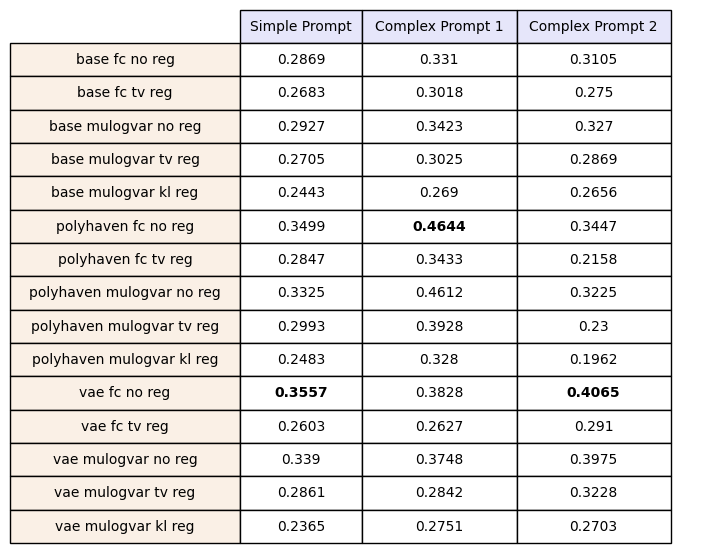

In [55]:
visualize_cos_similarities(table_cells)

## Image Comparison

This section compares in a single visualization all the results for each environment map for every optimization approach

Grouped by the prompt and the image

### Simple Prompt

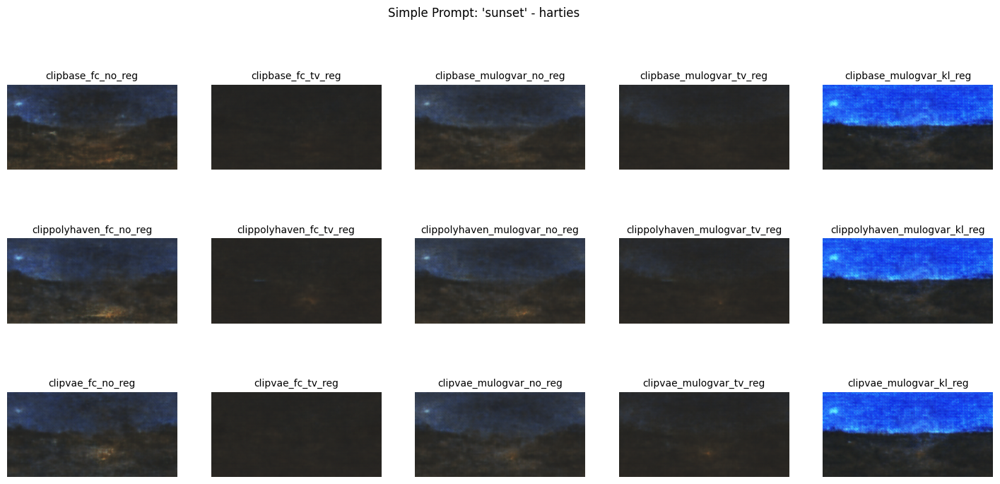

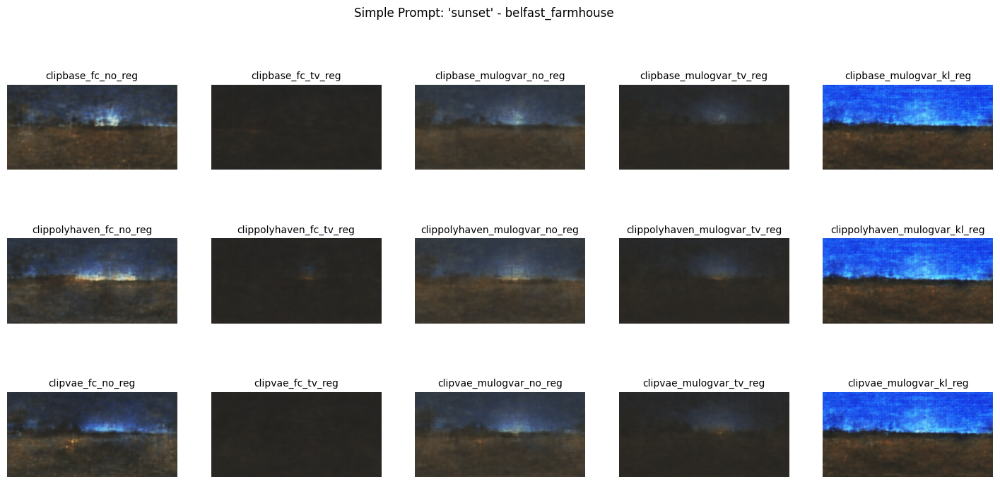

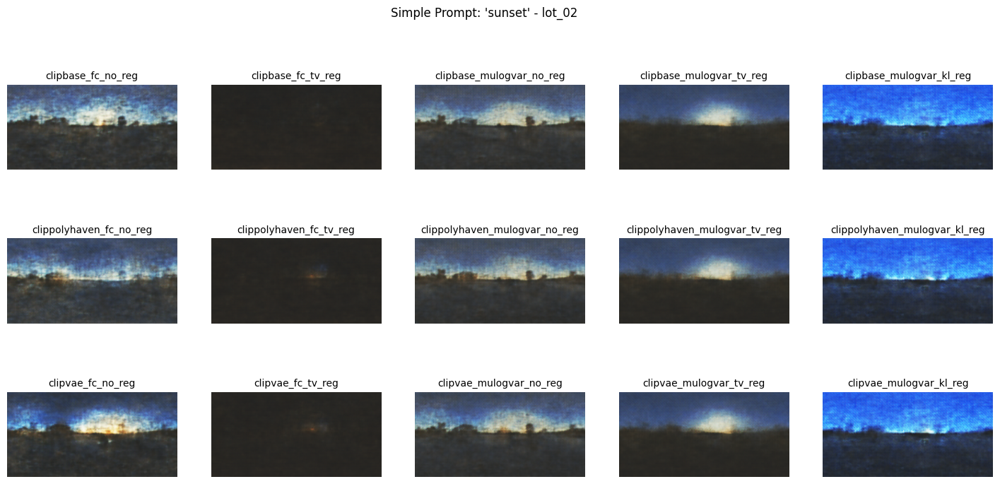

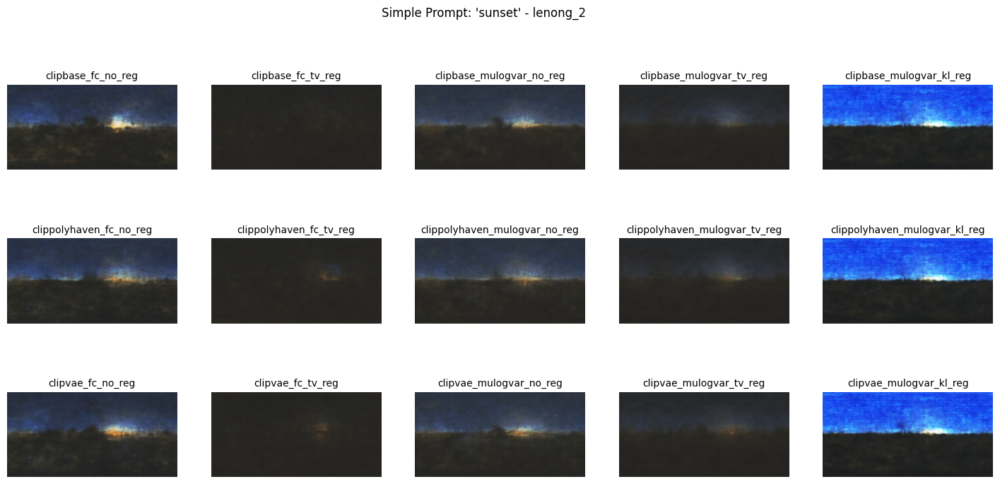

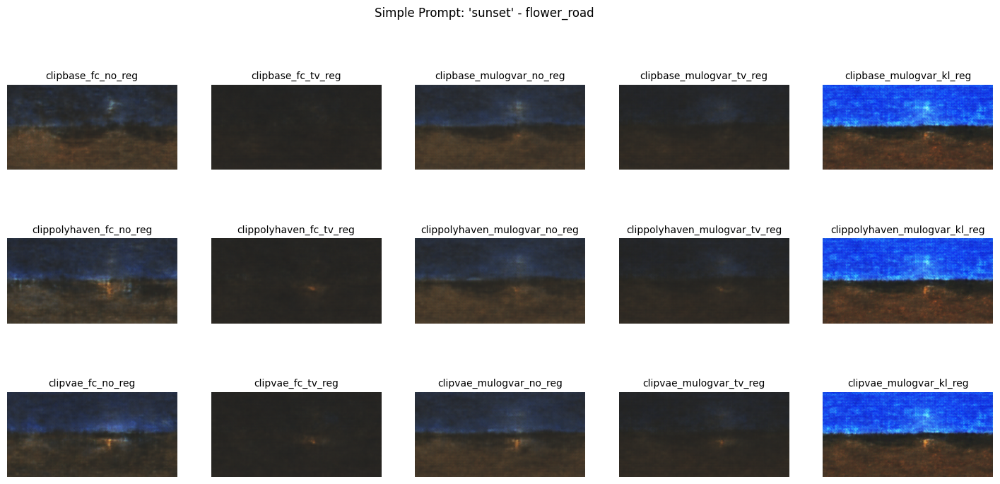

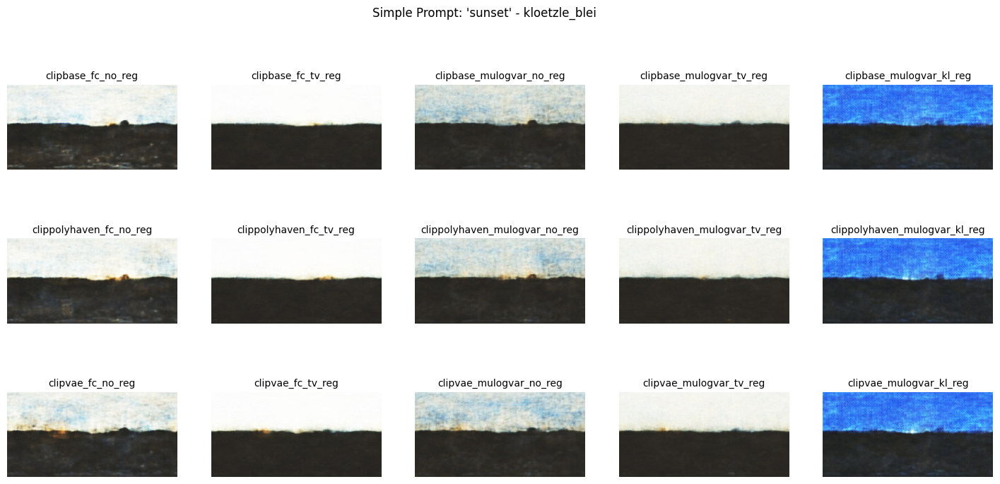

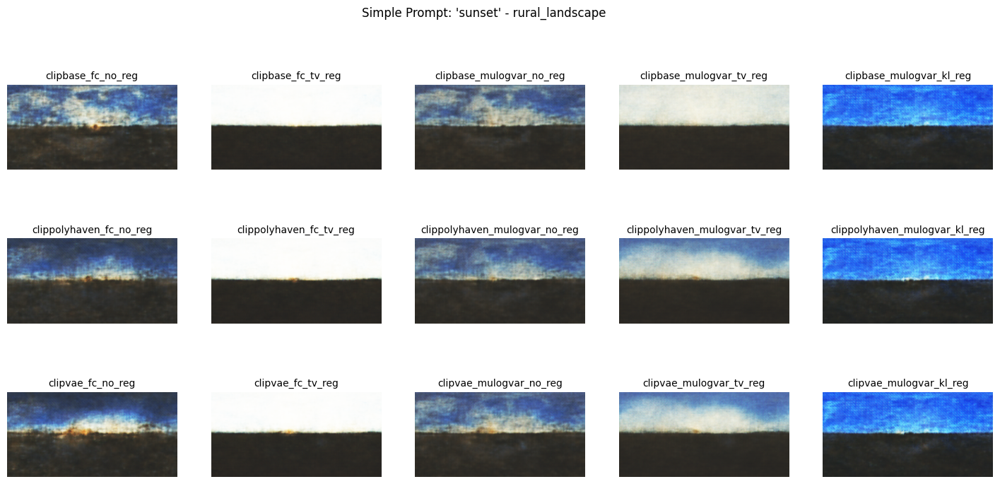

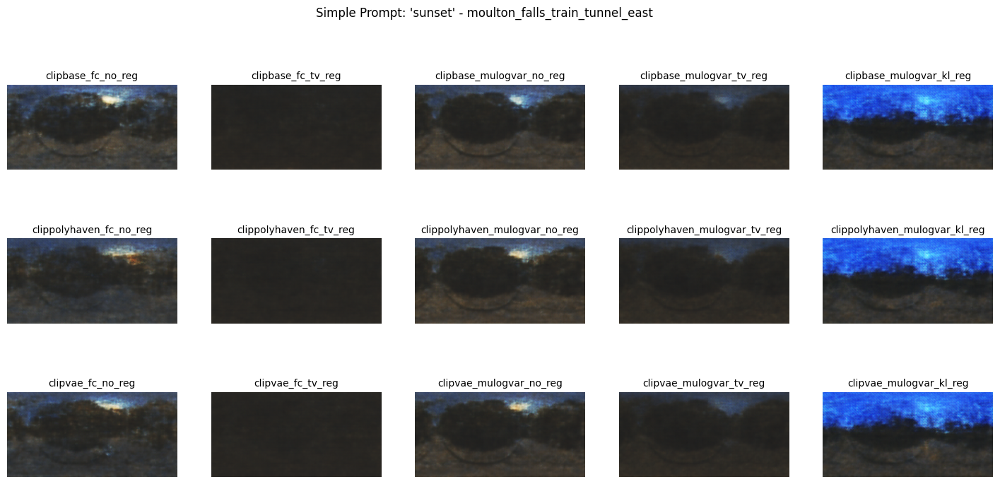

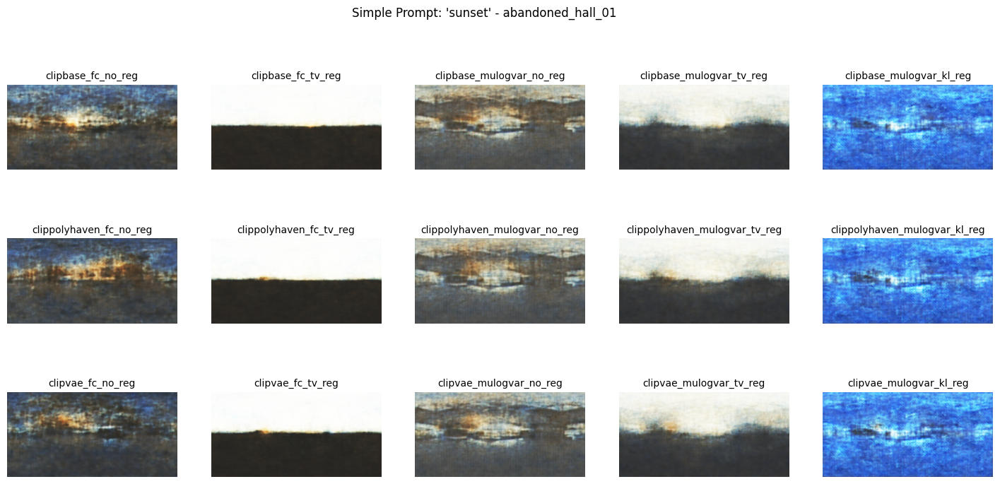

In [50]:
for i, image_label in enumerate(images_labels):
    title = image_label
    labels = list(results_simple_prompt.keys())
    imgs = []
    for label in labels:
        imgs.append(results_simple_prompt[label]["outputs"][i])
    plot_image_list(imgs, "Simple Prompt: 'sunset' - {}".format(image_label), labels, num_cols=5, figsize=(18, 8))
    

### Complex Prompt 1

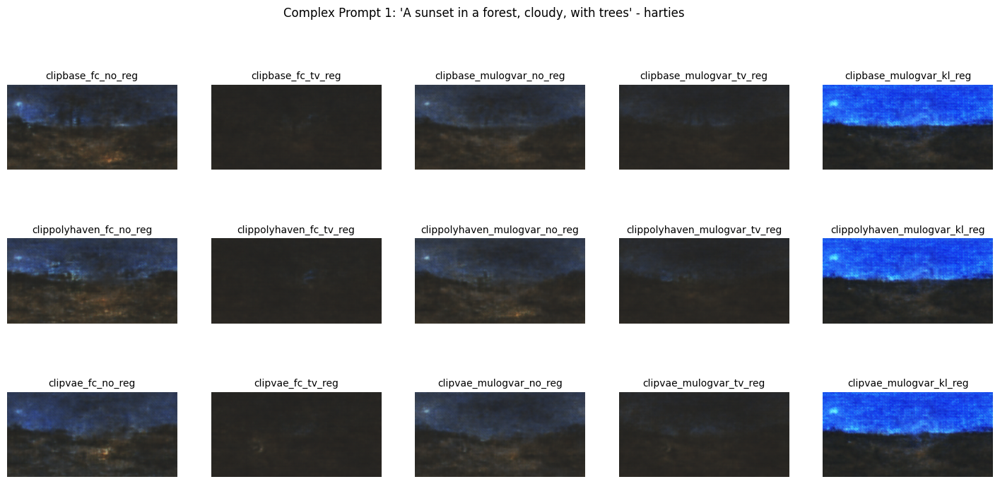

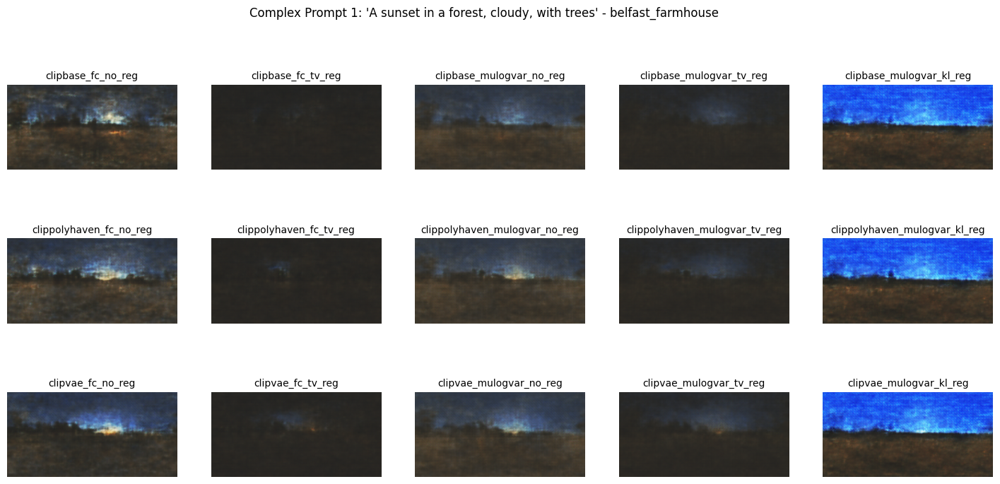

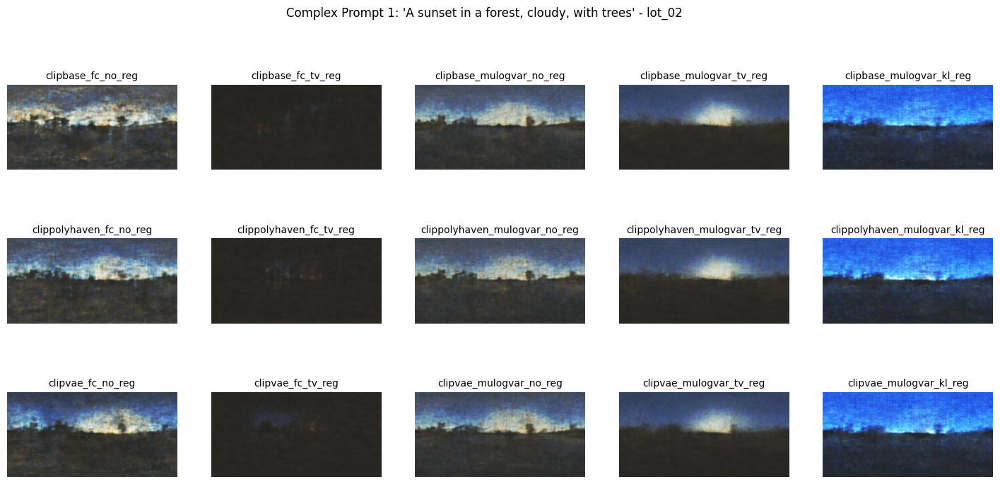

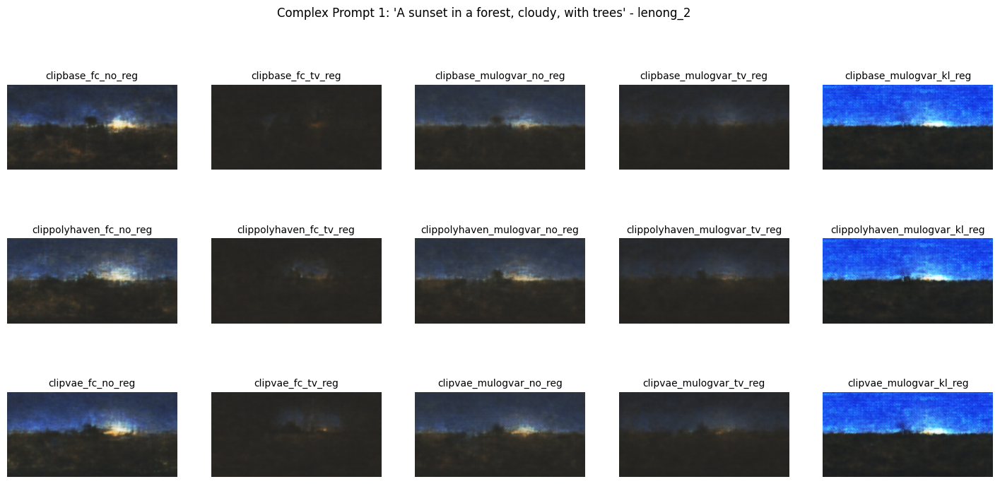

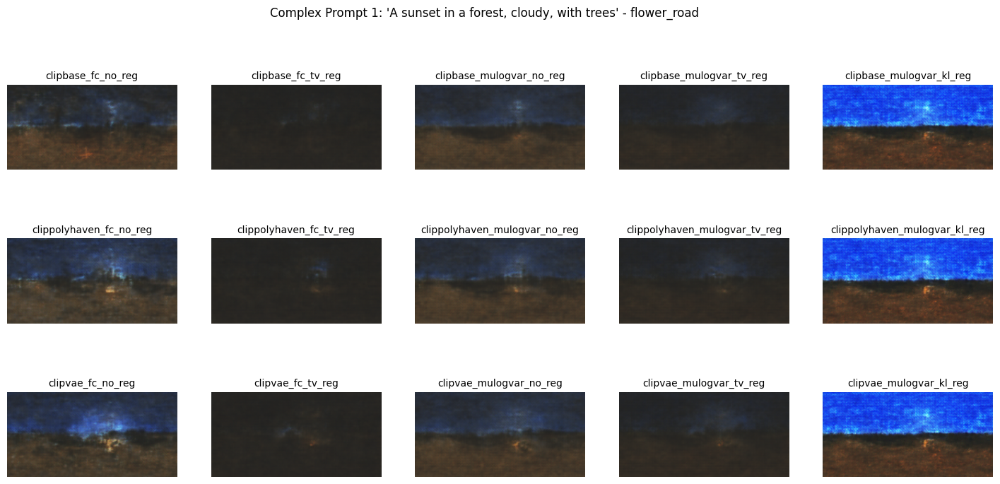

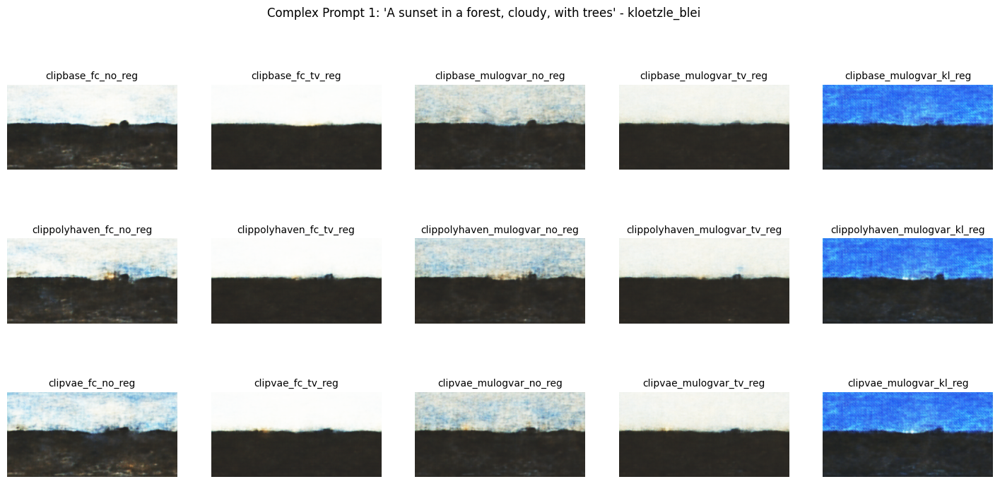

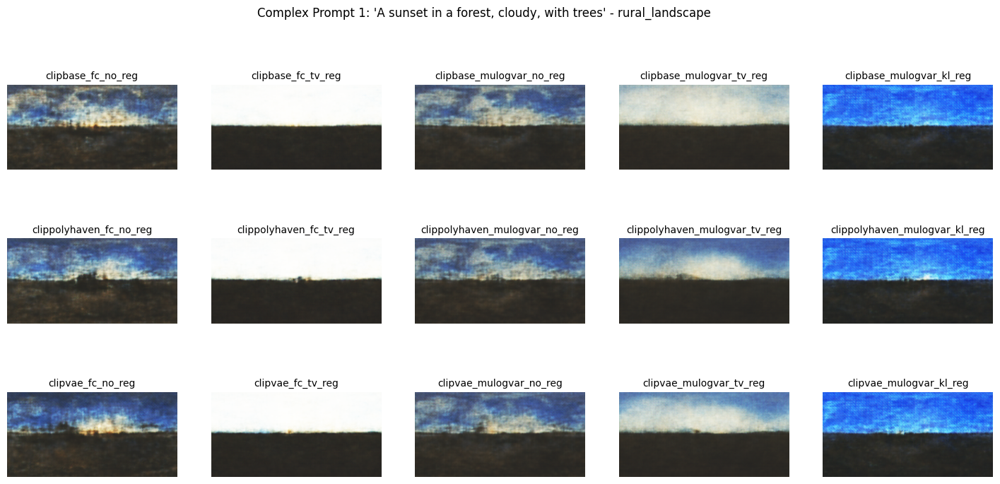

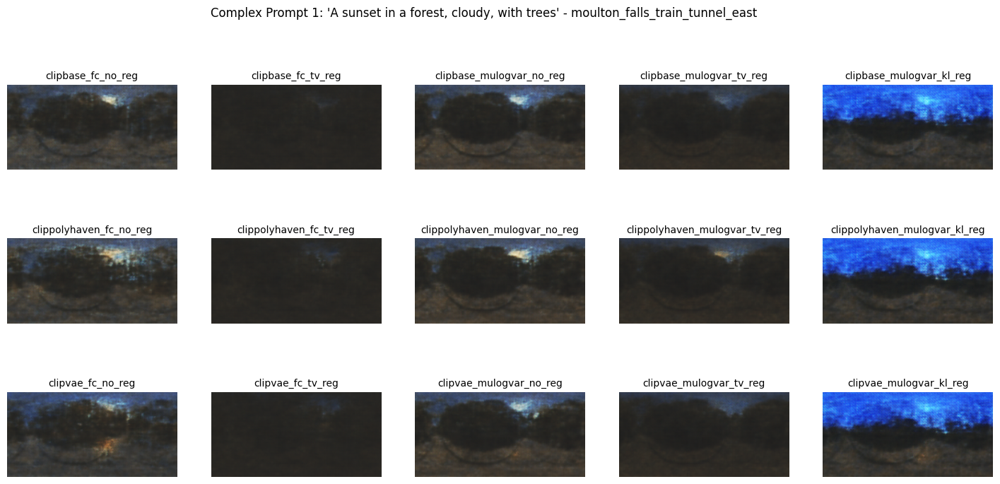

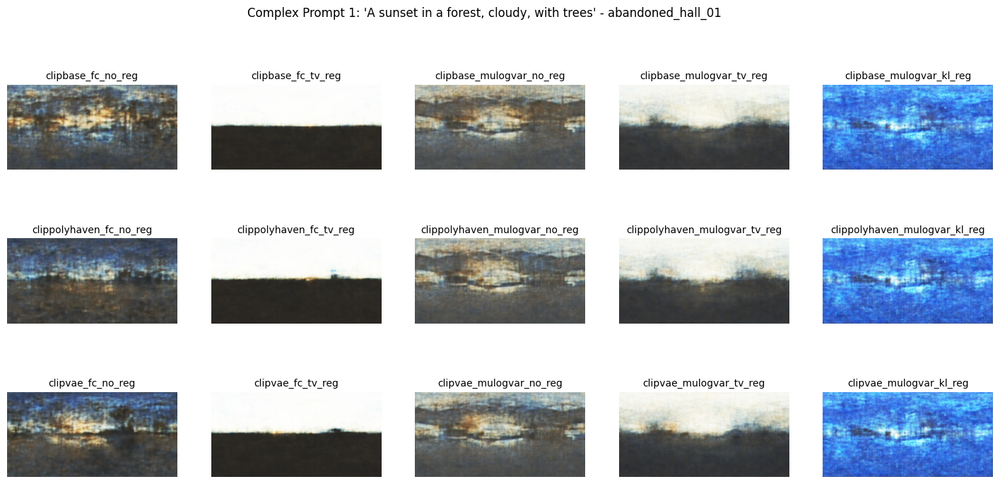

In [51]:
for i, image_label in enumerate(images_labels):
    title = image_label
    labels = list(results_complex_prompt_1.keys())
    imgs = []
    for label in labels:
        imgs.append(results_complex_prompt_1[label]["outputs"][i])
    plot_image_list(imgs, "Complex Prompt 1: 'A sunset in a forest, cloudy, with trees' - {}".format(image_label), labels, num_cols=5, figsize=(18, 8))
    

### Complex Prompt 2

In [ ]:
for i, image_label in enumerate(images_labels):
    title = image_label
    labels = list(results_complex_prompt_2.keys())
    imgs = []
    for label in labels:
        imgs.append(results_complex_prompt_2[label]["outputs"][i])
    plot_image_list(imgs, "Complex Prompt 2: 'A sunset in a forest, cloudy, with trees' - {}".format(image_label), labels, num_cols=5, figsize=(18, 8))
    

## Model Gallery

This section shows all the results for a batch of environment maps 

Grouped by the prompt, the model and the type of optimization/regularization


### Simple Prompt

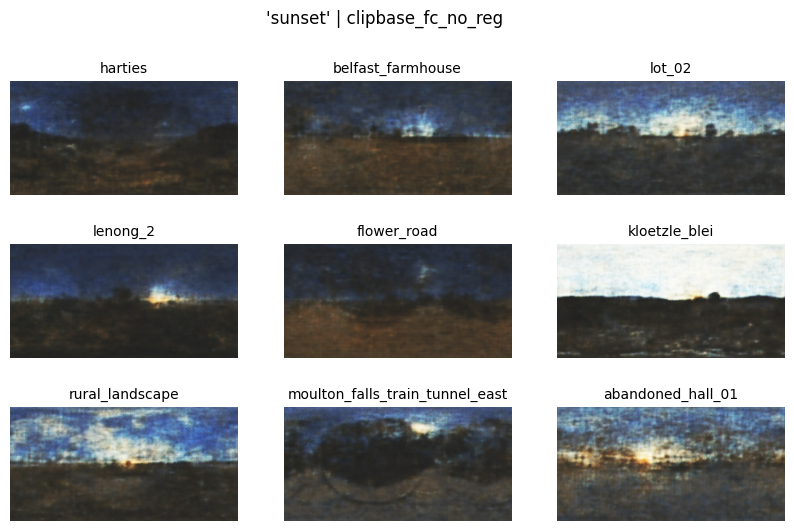

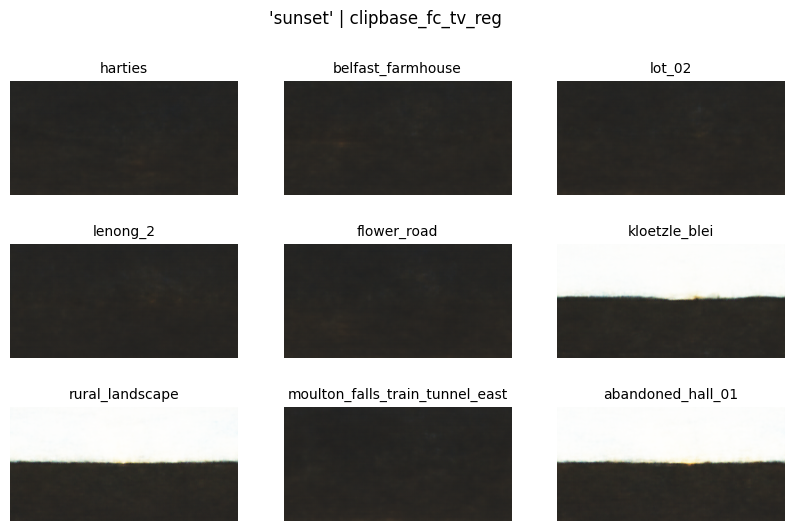

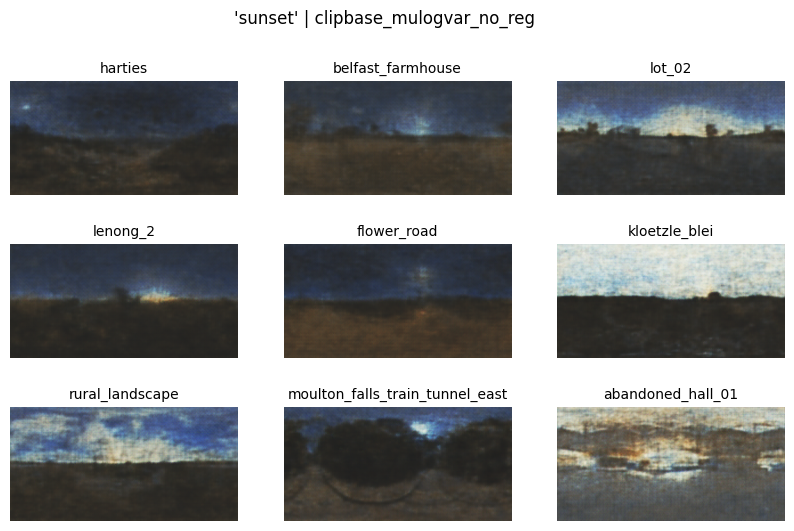

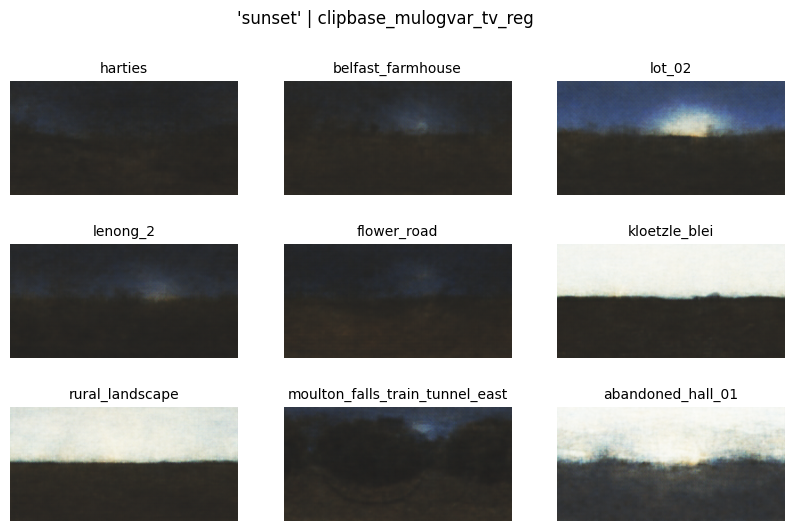

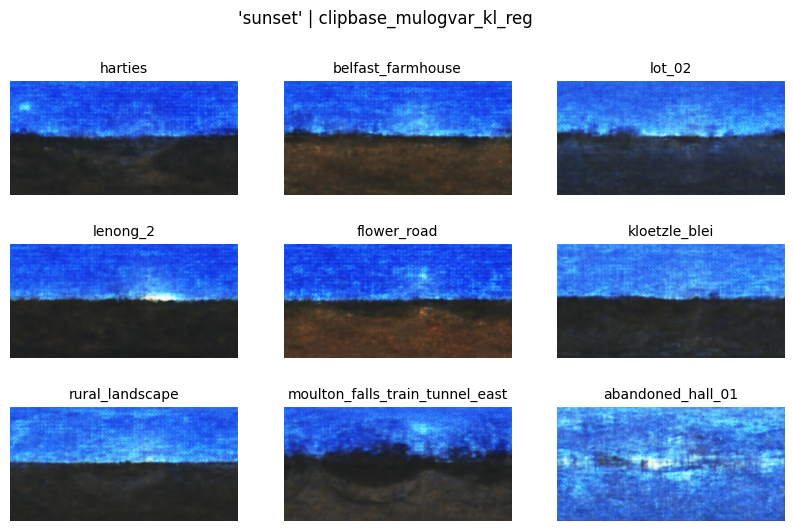

...

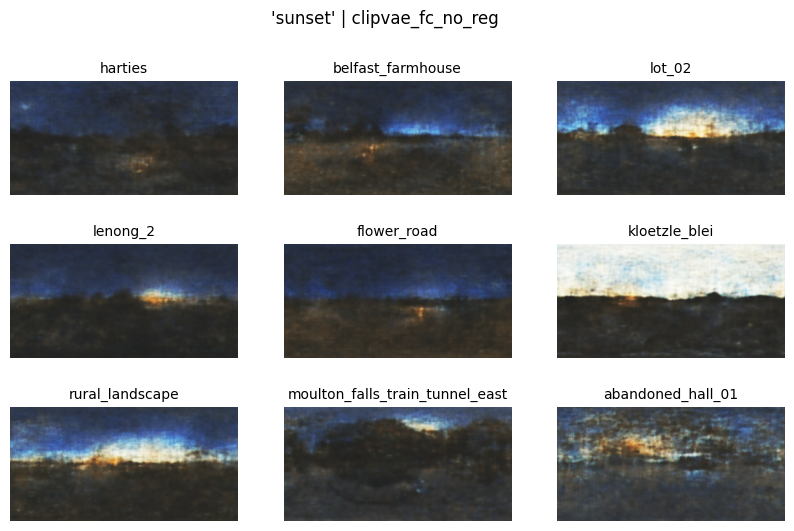

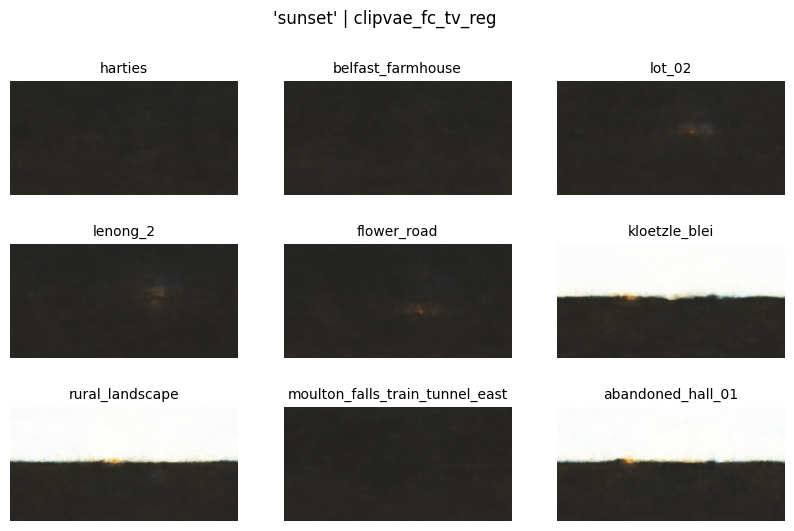

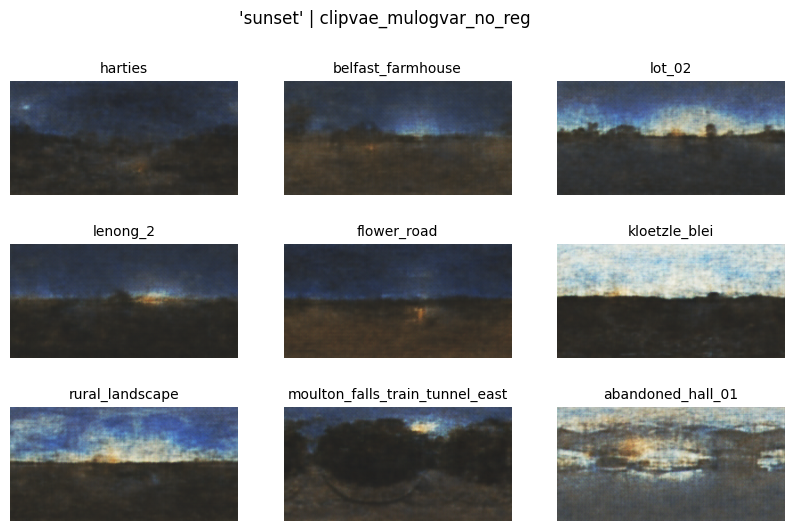

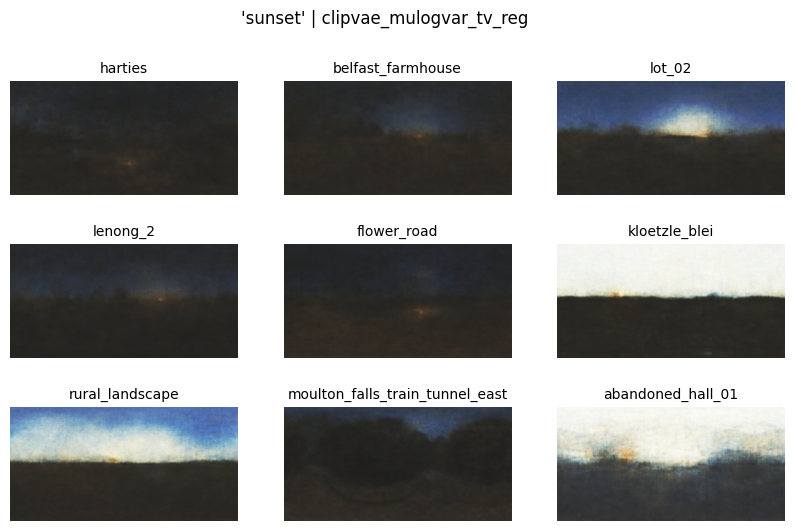

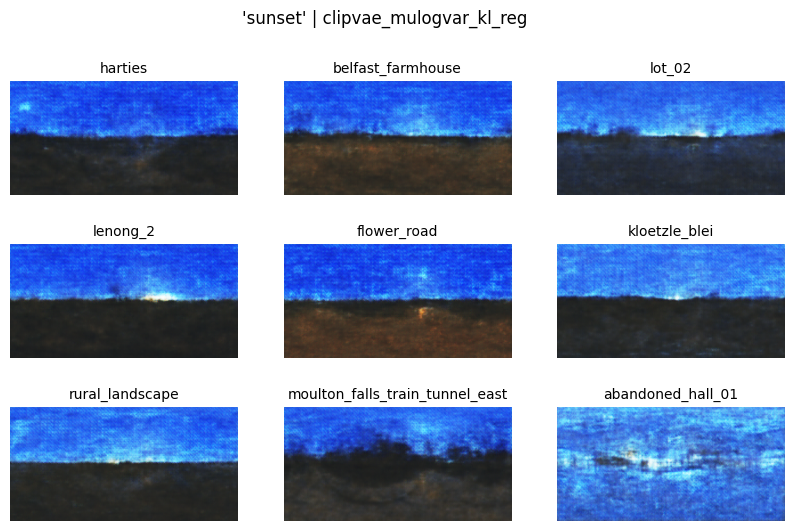

In [59]:
keys = results_simple_prompt.keys()

for key in keys:
    plot_image_list(results_simple_prompt[key]["outputs"], "'sunset' | {}".format(key), images_labels)

### Complex Prompt 1

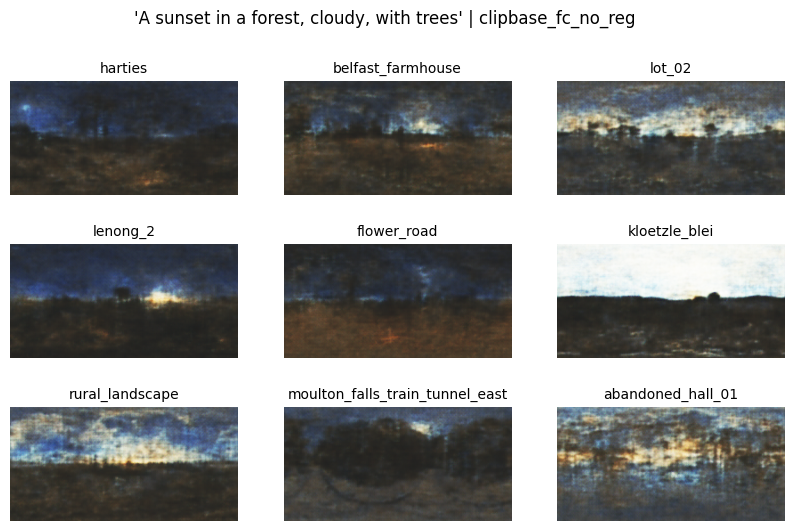

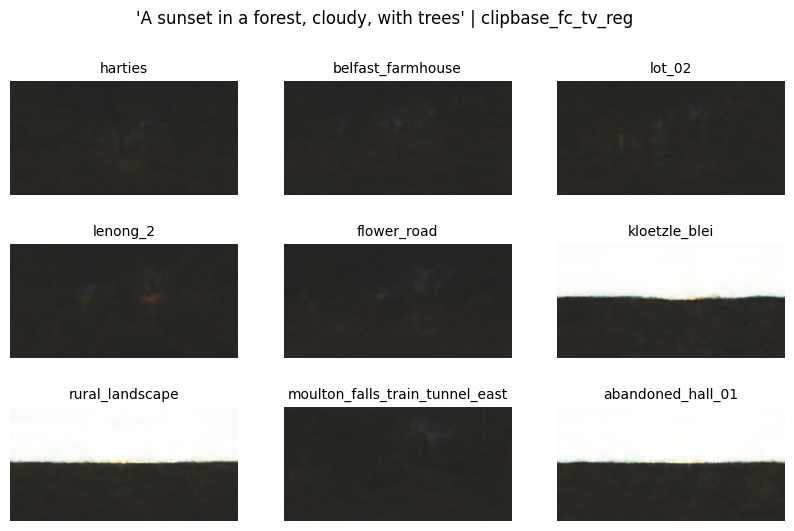

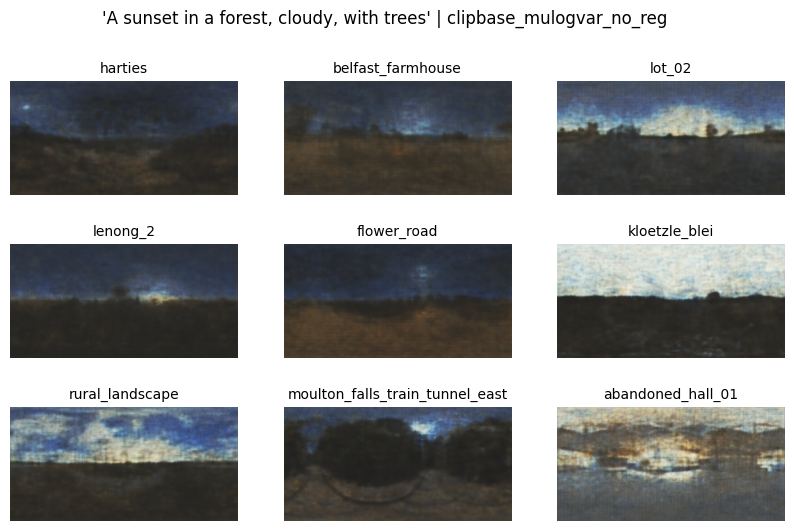

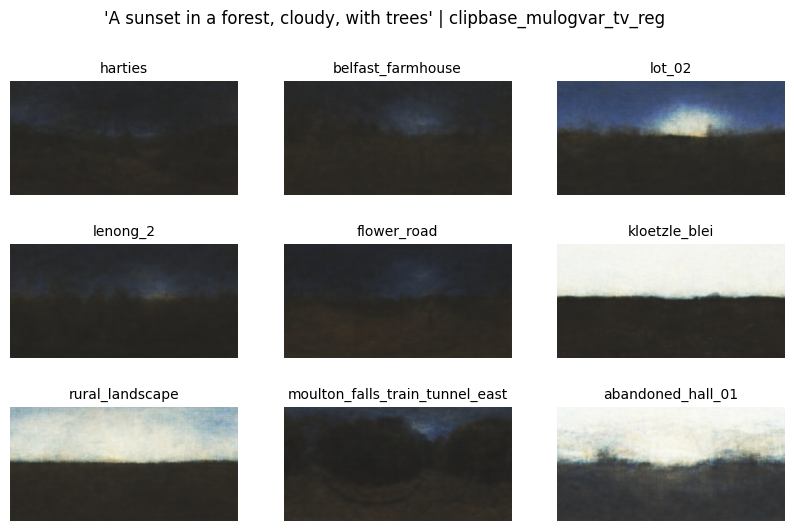

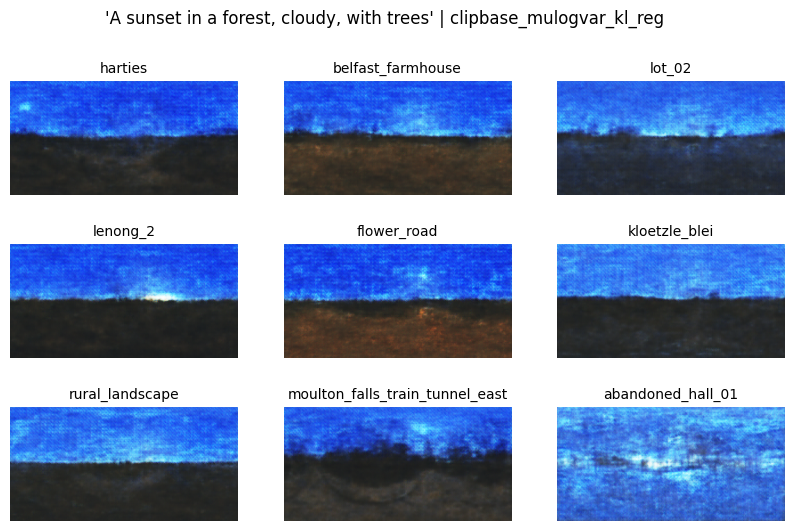

...

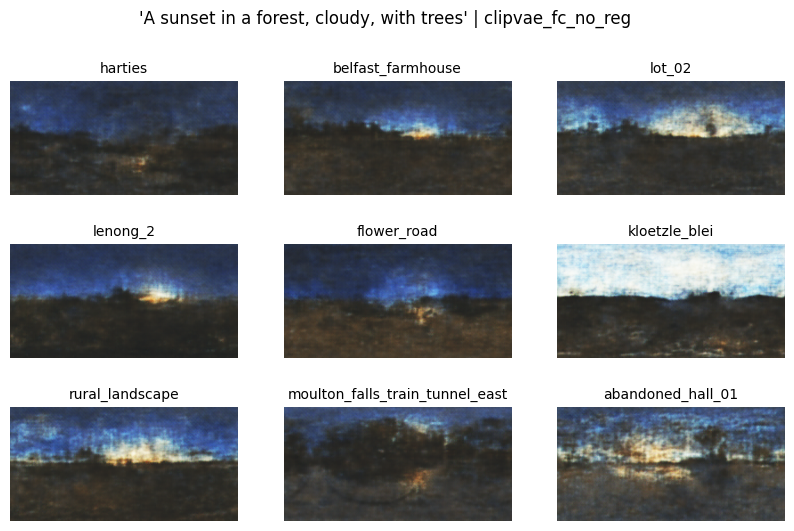

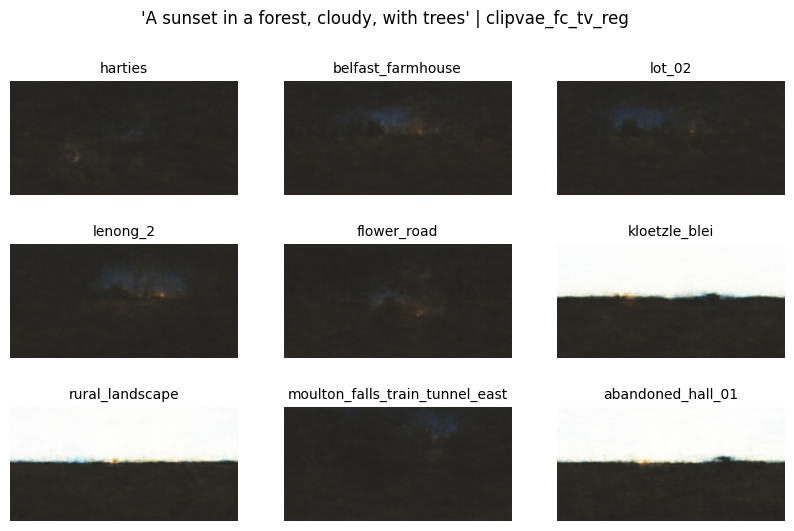

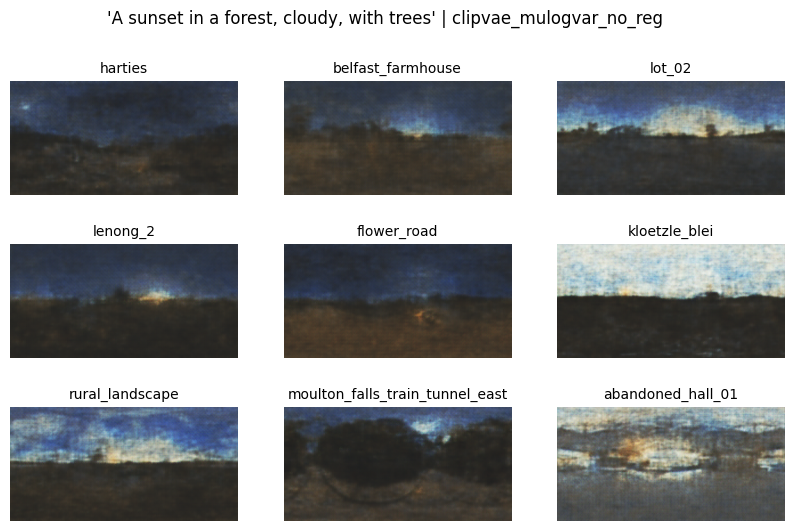

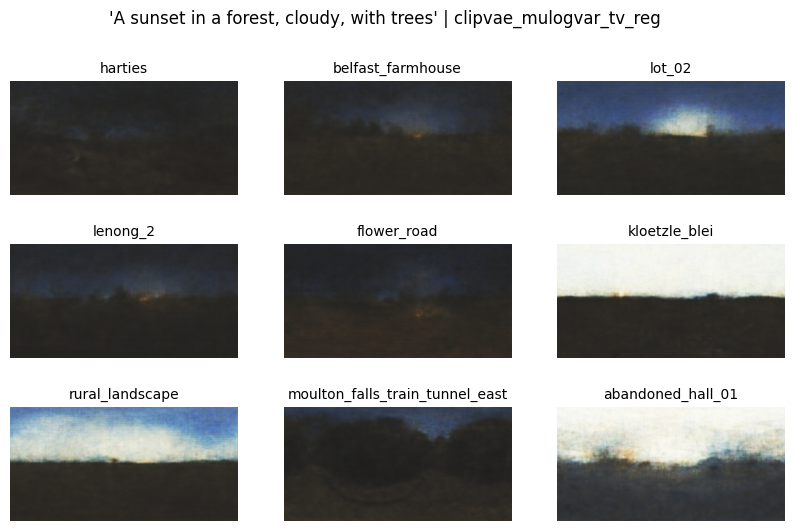

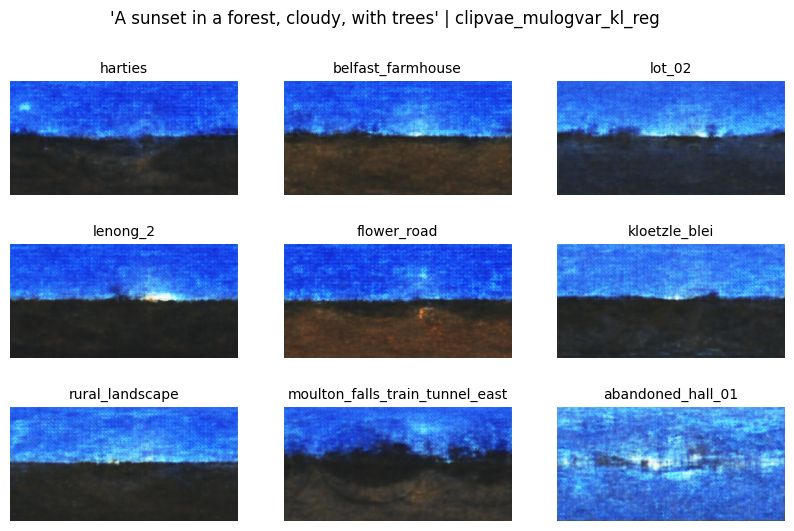

In [58]:
keys = results_simple_prompt.keys()

for key in keys:
    plot_image_list(results_complex_prompt_1[key]["outputs"], "'A sunset in a forest, cloudy, with trees' | {}".format(key), images_labels)

### Complex Prompt 2

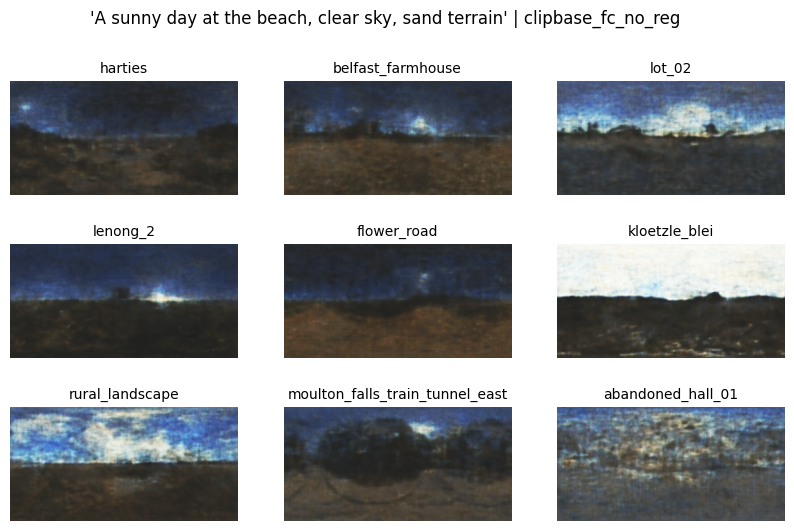

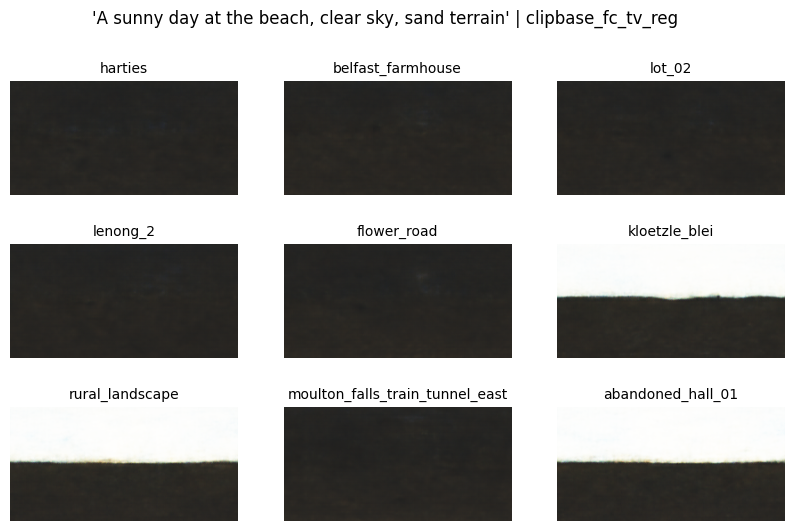

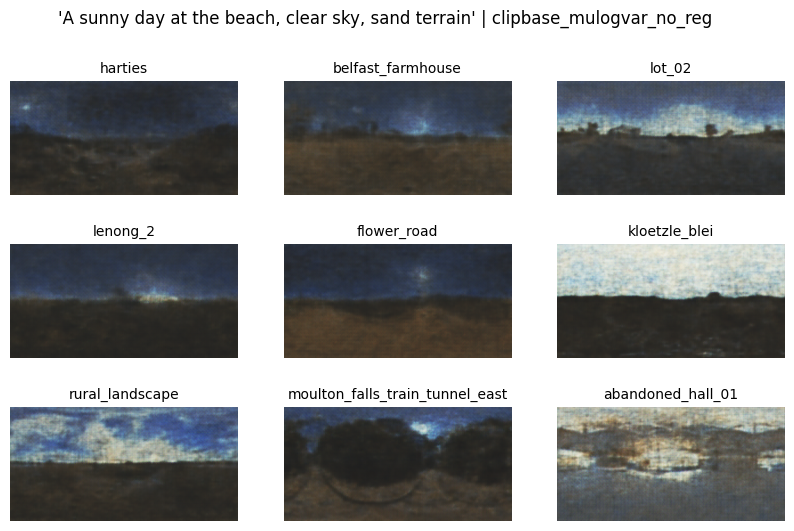

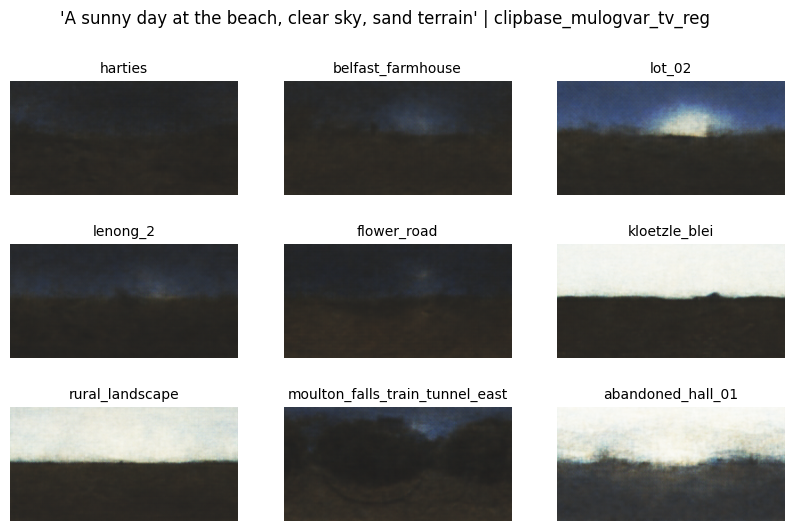

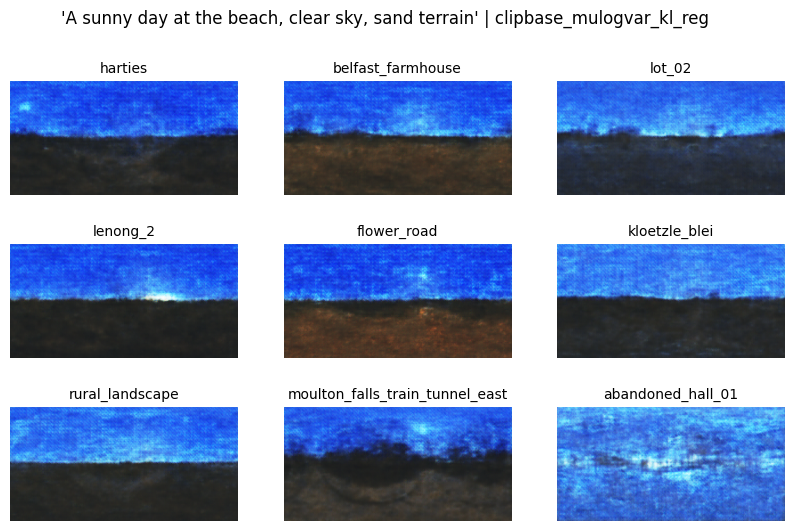

...

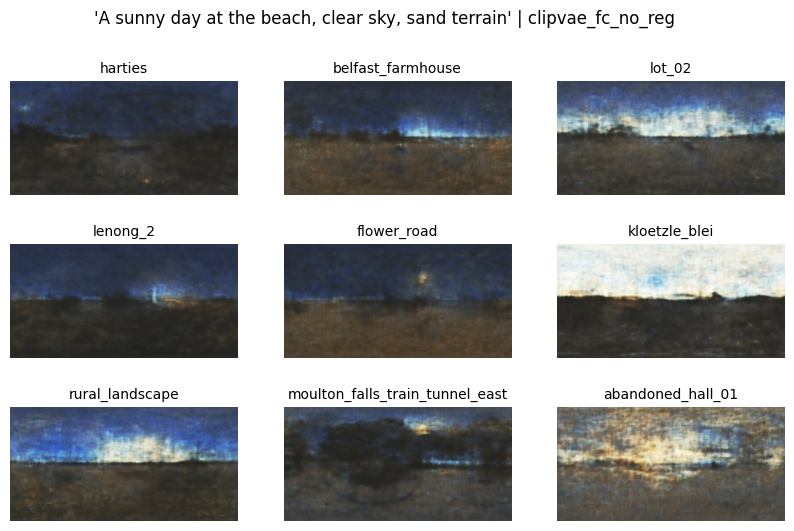

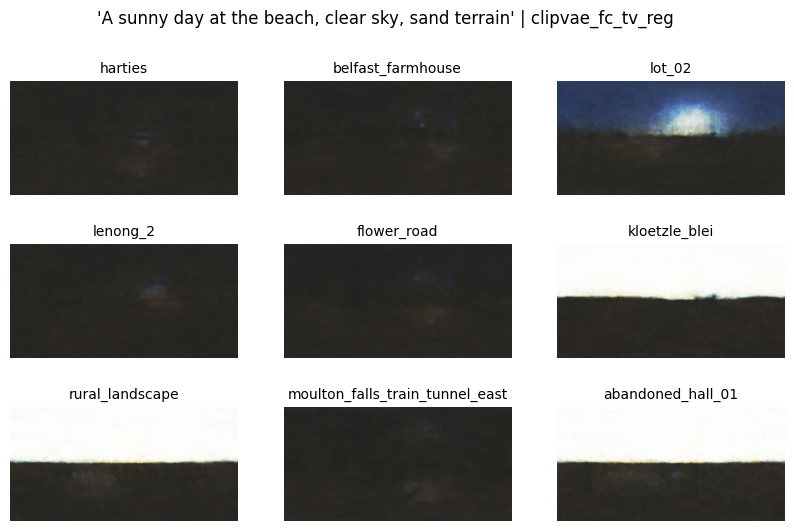

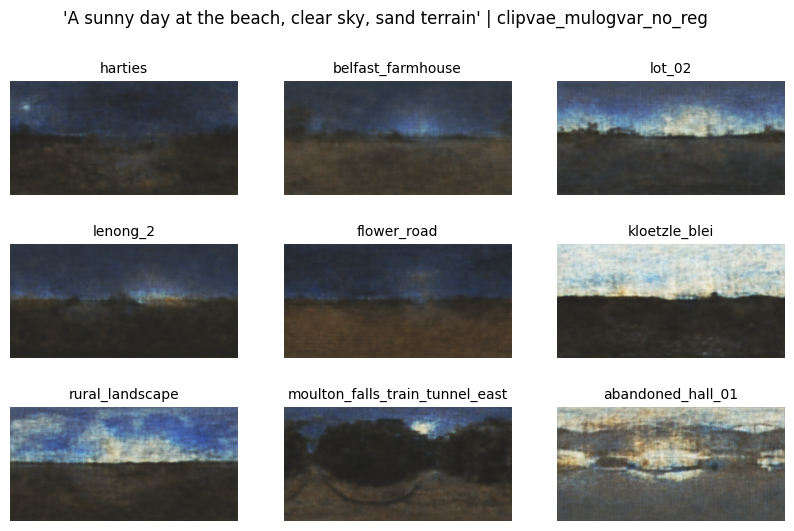

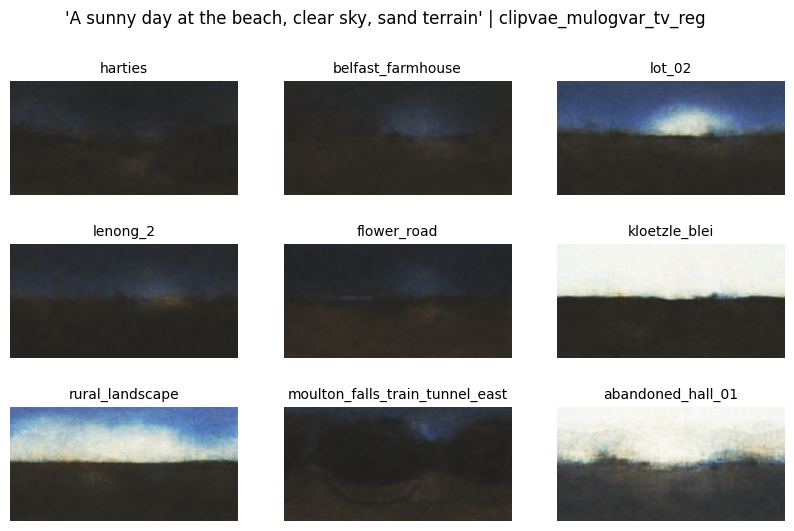

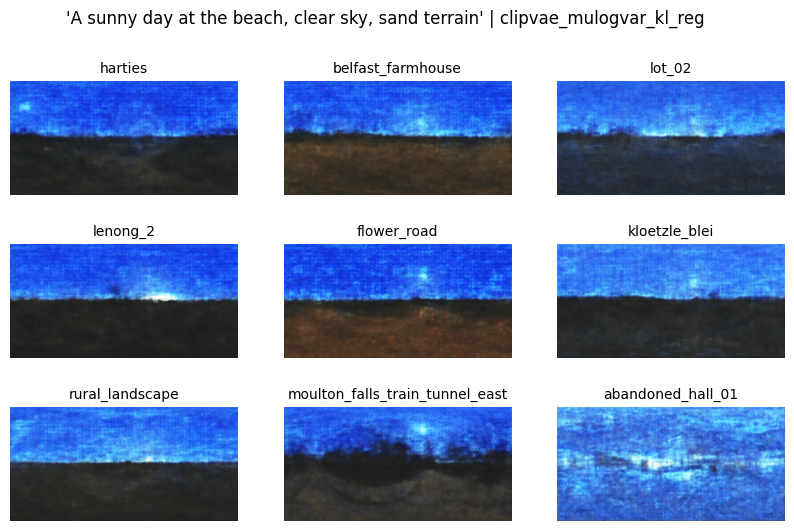

In [57]:
keys = results_simple_prompt.keys()

for key in keys:
    plot_image_list(results_complex_prompt_2[key]["outputs"], "'A sunny day at the beach, clear sky, sand terrain' | {}".format(key), images_labels)